In [1]:
import pandas as pd
import snscrape.modules.twitter as sntwitter
import itertools
from tqdm.notebook import tqdm

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns
import nest_asyncio
import re
from textblob import TextBlob
from nltk.tokenize import WordPunctTokenizer
from nltk.corpus import stopwords   
from datetime import datetime
import glob                     
import os
nest_asyncio.apply()
import nltk
nltk.download('stopwords')
from nltk.tokenize import word_tokenize
from wordcloud import WordCloud

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\LAWRENCE\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


### Data Collection

In [157]:
bank_name={'Guarantee Trust Bank':'gtb OR \ gtbank',
    'Zenith Bank':'zenith bank',
    'UBA':'UBA',
    'Access Bank':'access bank',
    'Fidelity Bank':'fidelity bank',
    'Eco Bank':'eco bank',
    'First Bank':'first bank',
    'Wema Bank':'wema bank',
    'Kuda bank':'kuda bank OR \ kuda',
    'FCMB':'fcmb', 
    'Sterling bank':'sterling bank',
    'Opay':'opay',
    'Palmpay':'palmpay'}

In [158]:
def scrape_config(search_string):
    loc = '9.0820, 8.6753, 923768km'
    twts = pd.DataFrame(itertools.islice(sntwitter.TwitterSearchScraper(
    f'{search_string[1]} + since:2023-01-01 until:2023-05-30 geocode:"{loc}"').get_items(), 10000))
    return twts

In [159]:
def run_snscrape(search_vals):
    
    #set empty dataframe for join
    out_df= pd.DataFrame()
    
    for bank in search_vals.items():
        print ("running for search item: "+bank[0]+"\n")
        print ("Search string: "+bank[1]+"\n")
                
        #run snscrape
        tweets_df = scrape_config(bank)
       
        #join Dataframes and create 'Bank' column
        tweets_df["Bank"]= bank[0]
        out_df = pd.concat([out_df,tweets_df])
        
    return out_df

In [160]:
tweets_df = run_snscrape(bank_name)

running for search item: Guarantee Trust Bank

Search string: gtb OR \ gtbank

running for search item: Zenith Bank

Search string: zenith bank

running for search item: UBA

Search string: UBA

running for search item: Access Bank

Search string: access bank

running for search item: Fidelity Bank

Search string: fidelity bank

running for search item: Eco Bank

Search string: eco bank

running for search item: First Bank

Search string: first bank

running for search item: Wema Bank

Search string: wema bank

running for search item: Kuda bank

Search string: kuda bank OR \ kuda

running for search item: FCMB

Search string: fcmb

running for search item: Sterling bank

Search string: sterling bank

running for search item: Opay

Search string: opay

running for search item: Palmpay

Search string: palmpay



In [162]:
pd.set_option('display.max_rows', 10000)
pd.set_option('display.max_columns', 10000)
pd.set_option('display.max_colwidth', None)

In [166]:
tweets_df.shape

(36099, 34)

In [164]:
tweets_df.head()

,url,date,rawContent,renderedContent,id,user,replyCount,retweetCount,likeCount,quoteCount,conversationId,lang,source,sourceUrl,sourceLabel,links,media,retweetedTweet,quotedTweet,inReplyToTweetId,inReplyToUser,mentionedUsers,coordinates,place,hashtags,cashtags,card,viewCount,vibe,bookmarkCount,pinned,Bank
0,https://twitter.com/ibrahimsalakos1/status/1663334148977590272,2023-05-29 23:58:59+00:00,"@iammrblossom Boss abeg nah, pls notice me, I've been repeating n dropping my details abeg locate me \n0139651266 Gtbank \nSalako Ibrahim \nGod bless you","@iammrblossom Boss abeg nah, pls notice me, I've been repeating n dropping my details abeg locate me \n0139651266 Gtbank \nSalako Ibrahim \nGod bless you",1663334148977590272,"{'username': 'ibrahimsalakos1', 'id': 3077187551, 'displayname': 'Ibrahim salako shola', 'rawDescription': 'A content creator, an event planner, a patriotic citizen', 'renderedDescription': 'A content creator, an event planner, a patriotic citizen', 'descriptionLinks': None, 'verified': False, 'created': 2015-03-07 13:11:06+00:00, 'followersCount': 16, 'friendsCount': 619, 'statusesCount': 142, 'favouritesCount': 31, 'listedCount': 0, 'mediaCount': 8, 'location': 'Lagos', 'protected': None, 'link': None, 'profileImageUrl': 'https://pbs.twimg.com/profile_images/1481583135305388035/qpQseF6a_normal.jpg', 'profileBannerUrl': 'https://pbs.twimg.com/profile_banners/3077187551/1425735625', 'label': None, 'blue': False, 'blueType': None}",0,0,0,0,1663333428396191744,en,None,None,None,None,None,None,None,1663333428396191744,"{'username': 'iammrblossom', 'id': 1489713490134720513, 'displayname': 'Mr Blossom 👑', 'rawDescription': None, 'renderedDescription': None, 'descriptionLinks': None, 'verified': None, 'created': None, 'followersCount': None, 'friendsCount': None, 'statusesCount': None, 'favouritesCount': None, 'listedCount': None, 'mediaCount': None, 'location': None, 'protected': None, 'link': None, 'profileImageUrl': None, 'profileBannerUrl': None, 'label': None, 'blue': None, 'blueType': None}","[{'username': 'iammrblossom', 'id': 1489713490134720513, 'displayname': 'Mr Blossom 👑', 'rawDescription': None, 'renderedDescription': None, 'descriptionLinks': None, 'verified': None, 'created': None, 'followersCount': None, 'friendsCount': None, 'statusesCount': None, 'favouritesCount': None, 'listedCount': None, 'mediaCount': None, 'location': None, 'protected': None, 'link': None, 'profileImageUrl': None, 'profileBannerUrl': None, 'label': None, 'blue': None, 'blueType': None}]",None,None,None,None,None,20,None,0,None,Guarantee Trust Bank
0,https://twitter.com/ChukaDominus/status/1663331973656354821,2023-05-29 23:50:20+00:00,@Boochi_dgreat 2389271613 Zenith Bank\nNjoku Chukwuka,@Boochi_dgreat 2389271613 Zenith Bank\nNjoku Chukwuka,1663331973656354821,"{'username': 'ChukaDominus', 'id': 1303572407463051265, 'displayname': 'The Dominus', 'rawDescription': 'Enterpreneur••| Engineer® MoneyMaker{£€$} Man Utd Faithful© Enigmatic°° Optimist/Realist.', 'renderedDescription': 'Enterpreneur••| Engineer® MoneyMaker{£€$} Man Utd Faithful© Enigmatic°° Optimist/Realist.', 'descriptionLinks': None, 'verified': False, 'created': 2020-09-09 05:54:36+00:00, 'followersCount': 554, 'friendsCount': 2518, 'statusesCount': 3650, 'favouritesCount': 6594, 'listedCount': 0, 'mediaCount': 28, 'location': 'Lagos, Nigeria', 'protected': None, 'link': None, 'profileImageUrl': 'https://pbs.twimg.com/profile_images/1303572875392299008/rWPdUtCT_normal.jpg', 'profileBannerUrl': 'https://pbs.twimg.com/profile_banners/1303572407463051265/1599918367', 'label': None, 'blue': False, 'blueType': None}",0,0,0,0,1663288124397551619,pl,None,None,None,None,None,None,None,1663288124397551619,"{'username': 'Boochi_dgreat', 'id': 1482117876458962945, 'displayname': 'BOOCHI TIPS', 'rawDescription': None, 'renderedDescription': None, 'descriptionLinks': None, 'verified': None, 'created': None, 'followersCount': None, 'friendsCount': None, 'statusesCount': None, 'fav

In [156]:
# saving the dataframe
#tweets_df.to_csv('raw_tweets.csv')

In [228]:
# read saved csv file
tweets_df = pd.read_csv('raw_tweets.csv', index_col=0)

In [229]:
tweets_df.head()

,Unnamed: 0,url,date,rawContent,renderedContent,id,user,replyCount,retweetCount,likeCount,quoteCount,conversationId,lang,source,sourceUrl,sourceLabel,links,media,retweetedTweet,quotedTweet,inReplyToTweetId,inReplyToUser,mentionedUsers,coordinates,place,hashtags,cashtags,card,viewCount,vibe,bookmarkCount,pinned,Bank
0,0,https://twitter.com/MssMuhsina/status/1663334330599452674,2023-05-29 23:59:42+00:00,@talktalker2talk HAPPY\nMOTHERS\nDAY.\n\nMuhsina Yusuf 1388340909 Access Bank.,@talktalker2talk HAPPY\nMOTHERS\nDAY.\n\nMuhsina Yusuf 1388340909 Access Bank.,1663334330599452674,"{'username': 'MssMuhsina', 'id': 1307232319359660032, 'displayname': 'Muhsina', 'rawDescription': '❤️❤️', 'renderedDescription': '❤️❤️', 'descriptionLinks': None, 'verified': False, 'created': datetime.datetime(2020, 9, 19, 8, 17, 46, tzinfo=datetime.timezone.utc), 'followersCount': 184, 'friendsCount': 286, 'statusesCount': 7457, 'favouritesCount': 4063, 'listedCount': 1, 'mediaCount': 75, 'location': 'Nigeria.', 'protected': None, 'link': None, 'profileImageUrl': 'https://pbs.twimg.com/profile_images/1662180947427508229/5bA4MfM6_normal.jpg', 'profileBannerUrl': 'https://pbs.twimg.com/profile_banners/1307232319359660032/1674245746', 'label': None, 'blue': False, 'blueType': None}",1,0,2,0,1663312723516555265,en,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.663313e+18,"{'username': 'talktalker2talk', 'id': 1657802341041467396, 'displayname': 'TALKTALKER_DE_COMEDIAN', 'rawDescription': None, 'renderedDescription': None, 'descriptionLinks': None, 'verified': None, 'created': None, 'followersCount': None, 'friendsCount': None, 'statusesCount': None, 'favouritesCount': None, 'listedCount': None, 'mediaCount': None, 'location': None, 'protected': None, 'link': None, 'profileImageUrl': None, 'profileBannerUrl': None, 'label': None, 'blue': None, 'blueType': None}","[{'username': 'talktalker2talk', 'id': 1657802341041467396, 'displayname': 'TALKTALKER_DE_COMEDIAN', 'rawDescription': None, 'renderedDescription': None, 'descriptionLinks': None, 'verified': None, 'created': None, 'followersCount': None, 'friendsCount': None, 'statusesCount': None, 'favouritesCount': None, 'listedCount': None, 'mediaCount': None, 'location': None, 'protected': None, 'link': None, 'profileImageUrl': None, 'profileBannerUrl': None, 'label': None, 'blue': None, 'blueType': None}]",NaN,NaN,NaN,NaN,NaN,12.0,NaN,0,NaN,Access Bank
1,1,https://twitter.com/segun470413391/status/1663334076927946753,2023-05-29 23:58:41+00:00,@iammrblossom 0731732335 odutola segun access bank,@iammrblossom 0731732335 odutola segun access bank,1663334076927946753,"{'username': 'segun470413391', 'id': 1594445283286319104, 'displayname': 'segun', 'rawDescription': 'Simple n easy person to be with', 'renderedDescription': 'Simple n easy person to be with', 'descriptionLinks': None, 'verified': False, 'created': datetime.datetime(2022, 11, 20, 21, 40, 41, tzinfo=datetime.timezone.utc), 'followersCount': 52, 'friendsCount': 337, 'statusesCount': 3406, 'favouritesCount': 12258, 'listedCount': 0, 'mediaCount': 4, 'location': 'Nigeria', 'protected': None, 'link': None, 'profileImageUrl': 'https://pbs.twimg.com/profile_images/1631016622893813762/tF2XGga4_normal.jpg', 'profileBannerUrl': None, 'label': None, 'blue': False, 'blueType': None}",0,0,0,0,1663333428396191744,it,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.663333e+18,"{'username': 'iammrblossom', 'id': 1489713490134720513, 'displayname': 'Mr Blossom 👑', 'rawDescription': None, 'renderedDescription': None, 'descriptionLinks': None, 'verified': None, 'created': None, 'followersCount': None, 'friendsCount': None, 'statusesCount': None, 'favouritesCount': None, 'listedCount': None, 'mediaCount': None, 'location': None, 'protected': None, 'link': None, 'profileImageUrl': None, 'profileBannerUrl': None, 'label': None, 'blue': None, 'blueType': None}","[{'username': 'iammrblossom', 'id': 1489713490134720513, 'displayname': 'Mr Blossom 👑', 'rawDescription': None, 'renderedDescription': None, 'descri

### Data Cleaning

In [230]:
# remove Unmaned column
tweets_df = tweets_df.loc[:, ~tweets_df.columns.str.contains('^Unnamed')]

In [231]:
# check for duplicate tweets
tweets_df[tweets_df['rawContent'].duplicated()]

,url,date,rawContent,renderedContent,id,user,replyCount,retweetCount,likeCount,quoteCount,conversationId,lang,source,sourceUrl,sourceLabel,links,media,retweetedTweet,quotedTweet,inReplyToTweetId,inReplyToUser,mentionedUsers,coordinates,place,hashtags,cashtags,card,viewCount,vibe,bookmarkCount,pinned,Bank
20,https://twitter.com/segun470413391/status/1663330203739856901,2023-05-29 23:43:18+00:00,@iammrblossom 0731732335 odutola segun access bank,@iammrblossom 0731732335 odutola segun access bank,1663330203739856901,"{'username': 'segun470413391', 'id': 1594445283286319104, 'displayname': 'segun', 'rawDescription': 'Simple n easy person to be with', 'renderedDescription': 'Simple n easy person to be with', 'descriptionLinks': None, 'verified': False, 'created': datetime.datetime(2022, 11, 20, 21, 40, 41, tzinfo=datetime.timezone.utc), 'followersCount': 52, 'friendsCount': 337, 'statusesCount': 3406, 'favouritesCount': 12258, 'listedCount': 0, 'mediaCount': 4, 'location': 'Nigeria', 'protected': None, 'link': None, 'profileImageUrl': 'https://pbs.twimg.com/profile_images/1631016622893813762/tF2XGga4_normal.jpg', 'profileBannerUrl': None, 'label': None, 'blue': False, 'blueType': None}",0,0,0,0,1663322153087844354,it,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.663322e+18,"{'username': 'iammrblossom', 'id': 1489713490134720513, 'displayname': 'Mr Blossom 👑', 'rawDescription': None, 'renderedDescription': None, 'descriptionLinks': None, 'verified': None, 'created': None, 'followersCount': None, 'friendsCount': None, 'statusesCount': None, 'favouritesCount': None, 'listedCount': None, 'mediaCount': None, 'location': None, 'protected': None, 'link': None, 'profileImageUrl': None, 'profileBannerUrl': None, 'label': None, 'blue': None, 'blueType': None}","[{'username': 'iammrblossom', 'id': 1489713490134720513, 'displayname': 'Mr Blossom 👑', 'rawDescription': None, 'renderedDescription': None, 'descriptionLinks': None, 'verified': None, 'created': None, 'followersCount': None, 'friendsCount': None, 'statusesCount': None, 'favouritesCount': None, 'listedCount': None, 'mediaCount': None, 'location': None, 'protected': None, 'link': None, 'profileImageUrl': None, 'profileBannerUrl': None, 'label': None, 'blue': None, 'blueType': None}]",NaN,NaN,NaN,NaN,NaN,1.0,NaN,0,NaN,Access Bank
47,https://twitter.com/ClarenceOkah/status/1663319980195160065,2023-05-29 23:02:40+00:00,@iammrblossom 0801143797\nAccess Bank\nOkah Clarence,@iammrblossom 0801143797\nAccess Bank\nOkah Clarence,1663319980195160065,"{'username': 'ClarenceOkah', 'id': 1545541306365231111, 'displayname': 'okah clarence', 'rawDescription': '', 'renderedDescription': '', 'descriptionLinks': None, 'verified': False, 'created': datetime.datetime(2022, 7, 8, 22, 52, 51, tzinfo=datetime.timezone.utc), 'followersCount': 112, 'friendsCount': 922, 'statusesCount': 2591, 'favouritesCount': 2924, 'listedCount': 2, 'mediaCount': 60, 'location': '', 'protected': None, 'link': None, 'profileImageUrl': 'https://pbs.twimg.com/profile_images/1658751397335007234/OTMsxHuZ_normal.jpg', 'profileBannerUrl': 'https://pbs.twimg.com/profile_banners/1545541306365231111/1682898344', 'label': None, 'blue': False, 'blueType': None}",0,0,0,0,1663307037252415488,en,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.663307e+18,"{'username': 'iammrblossom', 'id': 1489713490134720513, 'displayname': 'Mr Blossom 👑', 'rawDescription': None, 'renderedDescription': None, 'descriptionLinks': None, 'verified': None, 'created': None, 'followersCount': None, 'friendsCount': None, 'statusesCount': None, 'favouritesCount': None, 'listedCount': None, 'mediaCount': None, 'location': None, 'protected': None, 'link': None, 'profileImageUrl': None, 'profileBannerUrl': None, 'label': None, 'blue': None, 'blueType': None}","[{'username': 'iammrblossom', 'id': 1489713490134720513, 'displayname': 'Mr Blossom 👑', 'rawDescription': None, 'renderedDescription': None, 'descriptionLinks': None, 'verified': None, 'created': None, 'followersCount': None, 'friendsCount': None

In [232]:
 # Drop duplicate tweets
tweets_df.drop_duplicates(subset='rawContent', keep=False, inplace=True)
tweets_df[tweets_df['rawContent'].duplicated()]

,url,date,rawContent,renderedContent,id,user,replyCount,retweetCount,likeCount,quoteCount,conversationId,lang,source,sourceUrl,sourceLabel,links,media,retweetedTweet,quotedTweet,inReplyToTweetId,inReplyToUser,mentionedUsers,coordinates,place,hashtags,cashtags,card,viewCount,vibe,bookmarkCount,pinned,Bank


In [233]:
tweets_df.shape

(33343, 32)

In [234]:
# rename rawContent to tweet
tweets_df.rename(columns = {'rawContent':'tweet'}, inplace = True)

In [235]:
tweets_df.columns

Index(['url', 'date', 'tweet', 'renderedContent', 'id', 'user', 'replyCount',
       'retweetCount', 'likeCount', 'quoteCount', 'conversationId', 'lang',
       'source', 'sourceUrl', 'sourceLabel', 'links', 'media',
       'retweetedTweet', 'quotedTweet', 'inReplyToTweetId', 'inReplyToUser',
       'mentionedUsers', 'coordinates', 'place', 'hashtags', 'cashtags',
       'card', 'viewCount', 'vibe', 'bookmarkCount', 'pinned', 'Bank'],
      dtype='object')

In [236]:
# function to clean tweet column
def clean_text(text):  
    pat1 = r'@[^ ]+'                   #@signs
    pat2 = r'https?://[A-Za-z0-9./]+'  #links
    pat3 = r'\'s'                      #floating s's
    pat4 = r'\#\w+'                     # hashtags
    pat5 = r'&amp '
    pat6 = r'[^A-Za-z\s]'         #remove non-alphabet
    pat7 = r'\n'
    combined_pat = r'|'.join((pat1, pat2,pat3,pat4,pat5, pat6, pat7))
    text = re.sub(combined_pat,"",text).lower()
    return text.strip()

In [237]:
tweets_df["tweet"] = tweets_df["tweet"].apply(clean_text)

In [238]:
tweets_df["tweet"]

0                                                                                                                          happymothersdaymuhsina yusuf  access bank
2                                                                                                   hi  thank you for reaching out kindly check dm for feedback jojo
3                                                                                                                                                      meaccess bank
4      hi   im sorry your message is yet to be responded to our team is doing their best to respond to every inbox ill get to you please exercise some patience jojo
5       hi  im sorry your message is yet to be responded to our team is doing their best to respond to every inbox ill get to you please exercise some patience jojo
                                                                                   ...                                                                              
395       

In [239]:
tweets_df["lang"].unique()

array(['en', 'it', 'ro', 'in', 'tl', 'ht', 'und', 'es', 'hi', 'da', 'de',
       'nl', 'qam', 'et', 'hu', 'qme', 'sl', 'fi', 'tr', 'zxx', 'qht',
       'pt', 'ca', 'pl', 'cs', 'lt', 'eu', 'fr', 'cy', 'no', 'is', 'sv',
       'vi', 'art', 'qst'], dtype=object)

In [240]:
#droping tweet rows which languange isn't english laguage
tweets_df = tweets_df[tweets_df["lang"].isin(['en'])]

In [241]:
tweets_df["lang"].unique()

array(['en'], dtype=object)

#### Any tweet that contains "thank you for contacting us" will be removed.

In [242]:
contacting_df = tweets_df.loc[tweets_df['tweet'].str.contains("thank you for contacting|thanks for contacting", case=False)]
contacting_df.head(2)

,url,date,tweet,renderedContent,id,user,replyCount,retweetCount,likeCount,quoteCount,conversationId,lang,source,sourceUrl,sourceLabel,links,media,retweetedTweet,quotedTweet,inReplyToTweetId,inReplyToUser,mentionedUsers,coordinates,place,hashtags,cashtags,card,viewCount,vibe,bookmarkCount,pinned,Bank
1407,https://twitter.com/fidelitybankplc/status/1663215582555062272,2023-05-29 16:07:50+00:00,hello thank you for contacting fidelity bank we sincerely apologize for the inconvenience experienced kindly provide your account number and exact error message to enable us assist you further,Hello @PhyliciaDinny. Thank you for contacting Fidelity Bank. We sincerely apologize for the inconvenience experienced. Kindly provide your account number and exact error message to enable us assist you further. #FidelityCares,1663215582555062272,"{'username': 'fidelitybankplc', 'id': 59601797, 'displayname': 'Fidelity Bank', 'rawDescription': 'Welcome to the official page of Fidelity Bank. We are here to make financial services easy and accessible to you. For help, email: True.serve@fidelitybank.ng', 'renderedDescription': 'Welcome to the official page of Fidelity Bank. We are here to make financial services easy and accessible to you. For help, email: True.serve@fidelitybank.ng', 'descriptionLinks': None, 'verified': False, 'created': datetime.datetime(2009, 7, 23, 21, 59, 12, tzinfo=datetime.timezone.utc), 'followersCount': 249249, 'friendsCount': 0, 'statusesCount': 85372, 'favouritesCount': 4031, 'listedCount': 192, 'mediaCount': 4446, 'location': 'Nigeria', 'protected': None, 'link': {'text': 'linktr.ee/fidelitybankplc', 'url': 'https://linktr.ee/fidelitybankplc', 'tcourl': 'https://t.co/W14F5PFGbr', 'indices': (0, 23)}, 'profileImageUrl': 'https://pbs.twimg.com/profile_images/740961032957353985/SIdWxKDG_normal.jpg', 'profileBannerUrl': 'https://pbs.twimg.com/profile_banners/59601797/1685614868', 'label': None, 'blue': False, 'blueType': None}",3,0,1,0,1663133494980034560,en,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.663200e+18,"{'username': 'PhyliciaDinny', 'id': 1316040051843903489, 'displayname': 'Phylicia Chi', 'rawDescription': None, 'renderedDescription': None, 'descriptionLinks': None, 'verified': None, 'created': None, 'followersCount': None, 'friendsCount': None, 'statusesCount': None, 'favouritesCount': None, 'listedCount': None, 'mediaCount': None, 'location': None, 'protected': None, 'link': None, 'profileImageUrl': None, 'profileBannerUrl': None, 'label': None, 'blue': None, 'blueType': None}","[{'username': 'PhyliciaDinny', 'id': 1316040051843903489, 'displayname': 'Phylicia Chi', 'rawDescription': None, 'renderedDescription': None, 'descriptionLinks': None, 'verified': None, 'created': None, 'followersCount': None, 'friendsCount': None, 'statusesCount': None, 'favouritesCount': None, 'listedCount': None, 'mediaCount': None, 'location': None, 'protected': None, 'link': None, 'profileImageUrl': None, 'profileBannerUrl': None, 'label': None, 'blue': None, 'blueType': None}]",NaN,NaN,['FidelityCares'],NaN,NaN,744.0,NaN,0,NaN,Fidelity Bank
1408,https://twitter.com/fidelitybankplc/status/1663213065704202241,2023-05-29 15:57:50+00:00,hello thank you for contacting fidelity bank we empathize with you on the issue raised kindly provide your account number date amount wrong and intended beneficiaries details via dm to enable us assist further,"Hello @deensterling1. Thank you for contacting Fidelity Bank. We empathize with you on the issue raised. Kindly provide your account number, date, amount, wrong and intended beneficiaries' details via DM to enable us assist further. #FidelityCares",1663213065704202241,"{'username': 'fidelitybankplc', 'id': 59601797, 'displayname': 'Fidelity Bank', 'rawDescription': 'Welcome to the official page of Fidelity Bank. We are here to make financial services easy and accessible to you. For help, email: True.serve@fidelitybank.ng', 'renderedDescription': 'Welcome to the official page of Fidelity Bank. We are here to make 

In [243]:
tweets_df = tweets_df.loc[~(tweets_df['tweet'].str.contains("thank you for contacting|thanks for contacting|thank you for reaching out|sorry your message is yet to be responded|apologize for any inconvenience|your complaint via dm", case=False))]

In [244]:
#df['UserName'] = df['url'].str.slice(0, 3)
tweets_df['User'] = tweets_df['url'].apply(lambda x: x.split('/')[3])

In [245]:
# selecting the important columns for this analysis
tweets_df = tweets_df[['date', 'tweet', 'likeCount', 'Bank', 'User']]

In [246]:
tweets_df.tail(10)

,date,tweet,likeCount,Bank,User
388,2023-05-29 13:42:20+00:00,i want you to go for that governorship ambition i dreamt of it im from enugu state,0,UBA,UbaJamesmark
389,2023-05-29 13:42:20+00:00,please do whatever you can to resume that declaration of not contesting again dm me for more clarification,0,UBA,UbaJamesmark
390,2023-05-29 13:42:20+00:00,sir please o,0,UBA,UbaJamesmark
391,2023-05-29 13:42:02+00:00,done that since boss even sent screenshots several times uba muraina zainab wuraola,0,UBA,ZainabMura54307
392,2023-05-29 13:41:10+00:00,i keep praying sirubatole samson,1,UBA,realST_1
393,2023-05-29 13:40:20+00:00,yaronan theyre all the same duk yan yunwane the moment they get what they want shiknan it all fake sympathy towards to masses yan kutumar uba masu ci da media,13,UBA,mni_JJ
394,2023-05-29 13:39:49+00:00,boss please consider me am been active for long please boss abeg you am going through alot i pray today will be my lucky day boss uba more blessings,0,UBA,terro_eyes
395,2023-05-29 13:39:26+00:00,make uba chillna only day in office you want to start cushioning its take time and more so nigerians are used to suffering and smiling,4,UBA,KingTemio
397,2023-05-29 13:30:43+00:00,breaking governor uba sani has announced the renaming of the entire stretch of rabah road as nasir elrufai way,564,UBA,InsideKaduna_
399,2023-05-29 13:33:09+00:00,ubasamuel anietie jimmyboss im very hungry please help me anything will do,0,UBA,Jimmy7543098451


### Data Preprocessing

In [247]:
print("Running sentiment process")

# creating two new columns(polarity and subjectivity)
def getSubjectivity(text):
    return TextBlob(text).sentiment.subjectivity
def getPolarity(text):
    return TextBlob(text).sentiment.polarity

tweets_df["Subjectivity"] = tweets_df['tweet'].apply(getSubjectivity)
tweets_df["Polarity"] = tweets_df['tweet'].apply(getPolarity)

Running sentiment process


In [248]:
tweets_df[['Subjectivity','Polarity','tweet']].head()

,Subjectivity,Polarity,tweet
0,0.00,0.0,happymothersdaymuhsina yusuf access bank
3,0.00,0.0,meaccess bank
11,0.45,0.3,please am a student and i need financial backing please someone so kind should do me a favour access bank
14,0.00,0.0,access bank
15,0.00,0.0,access bank


In [249]:
#creating a column to show if the tweet is positive, negative or neutral
def analysis(score):
    if score < 0:
        return "Negative"
    elif score == 0:
        return "Neutral"
    else:
        return "Positive"

tweets_df['Analysis'] = tweets_df['Polarity'].apply(analysis)

In [250]:
tweets_df["date"] = pd.to_datetime(tweets_df["date"])

# #set index = date so as to create rolling mean 
# tweets_df = tweets_df.sort_values("date").set_index("date")

In [251]:
tweets_df.head()

,date,tweet,likeCount,Bank,User,Subjectivity,Polarity,Analysis
0,2023-05-29 23:59:42+00:00,happymothersdaymuhsina yusuf access bank,2,Access Bank,MssMuhsina,0.00,0.0,Neutral
3,2023-05-29 23:57:37+00:00,meaccess bank,0,Access Bank,Kantiokfaith1,0.00,0.0,Neutral
11,2023-05-29 23:53:19+00:00,please am a student and i need financial backing please someone so kind should do me a favour access bank,0,Access Bank,Tordue23,0.45,0.3,Positive
14,2023-05-29 23:45:57+00:00,access bank,0,Access Bank,Tordue23,0.00,0.0,Neutral
15,2023-05-29 23:45:16+00:00,access bank,0,Access Bank,amaciouslala,0.00,0.0,Neutral


In [252]:
# check for duplicate tweets
tweets_df['tweet'].duplicated().sum()

4729

In [253]:
# Drop duplicate tweets
tweets_df.drop_duplicates(subset='tweet', keep=False, inplace=True)
tweets_df['tweet'].duplicated().sum()

0

### Data Visualization and Exploratory

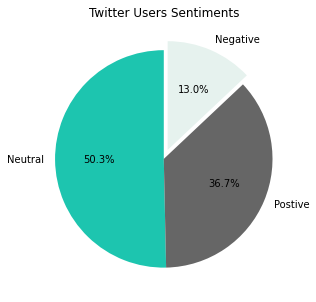

In [254]:
# Plotting a pie chart to show distribution of Sentiments
plt.figure(figsize=[7,5], facecolor='none')
plt.pie(tweets_df['Analysis'].value_counts(), labels=['Neutral','Postive', "Negative"], colors=['#1dc5af', '#666666', '#E6f2ee'], startangle=90, explode= [0,0,0.09], autopct='%1.1f%%');
plt.title('Twitter Users Sentiments');

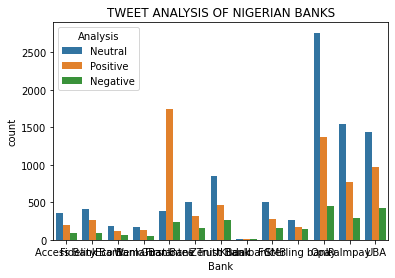

In [255]:
sns.countplot(data=tweets_df, x='Bank', hue='Analysis')
plt.title('Tweet Analysis of Nigerian Banks'.upper())

plt.show()

#### Creating a word cloud

In [256]:
#import nltk
#nltk.download('stopwords')
#from nltk.corpus import stopwords

stop_words = stopwords.words('english')
stop_words = stop_words + ['u', 'na', 'know', 'one', 'go', 'make', 'see', 'dont', 'amp', 'im', 'cant']
tweets_df['cleaned_words'] = tweets_df['tweet'].astype(str).apply(lambda x: ' '.join([word for word in x.split() if word not in (stop_words)]))

In [257]:
print(stop_words)

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

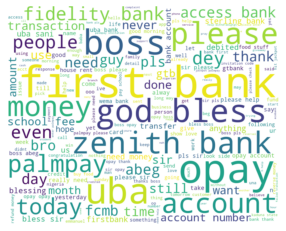

In [258]:
#Creating the text variable
text = " ".join(i for i in tweets_df.cleaned_words)

wc = WordCloud(width = 1000, height = 800, background_color = "white").generate(text)

#Remove axis and display the data as image
plt.axis("off")
plt.imshow(wc, interpolation = "bilinear")

In [259]:
tweets_df.columns

Index(['date', 'tweet', 'likeCount', 'Bank', 'User', 'Subjectivity',
       'Polarity', 'Analysis', 'cleaned_words'],
      dtype='object')

In [260]:
# save processed tweets as csv
tweets_df.to_csv('processed_bank_tweets.csv')